# Tomato Plant Disease Detection Using Deep Learning - CNN

## Importing The Libraries

In [141]:
import cv2
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.keras import models, layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Dense, Flatten, Dropout, GlobalAveragePooling2D, AveragePooling2D, MaxPooling2D, BatchNormalization
from tensorflow.keras.applications import DenseNet121

## Data Preprocessing

### Training Image preprocessing

In [142]:
train_data = tf.keras.utils.image_dataset_from_directory(
    "/kaggle/input/tomatodiseasedleaves/tomato/train",
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False)

train_data = train_data.map(lambda x, y: (x / 255.0, y))

Found 11969 files belonging to 13 classes.


### Validation Image Preprocessing

In [143]:
val_data = tf.keras.preprocessing.image_dataset_from_directory(
    "/kaggle/input/tomatodiseasedleaves/tomato/val",
    labels="inferred",
    label_mode="categorical",
    class_names=None,
    color_mode="rgb",
    batch_size=32,
    image_size=(128, 128),
    shuffle=True,
    seed=None,
    validation_split=None,
    subset=None,
    interpolation="bilinear",
    follow_links=False,
    crop_to_aspect_ratio=False
)
val_data = val_data.map(lambda x, y: (x / 255.0, y))

Found 1479 files belonging to 13 classes.


In [144]:
import tensorflow as tf

def preprocess_image(image, label):
    
    if image.shape[-1] == 1:  # if the image is grayscale
        image = tf.image.grayscale_to_rgb(image)
        
    resized_image = tf.image.resize(image, (256, 256))
    return resized_image, label

## Visualizing The Data

### Black Mold

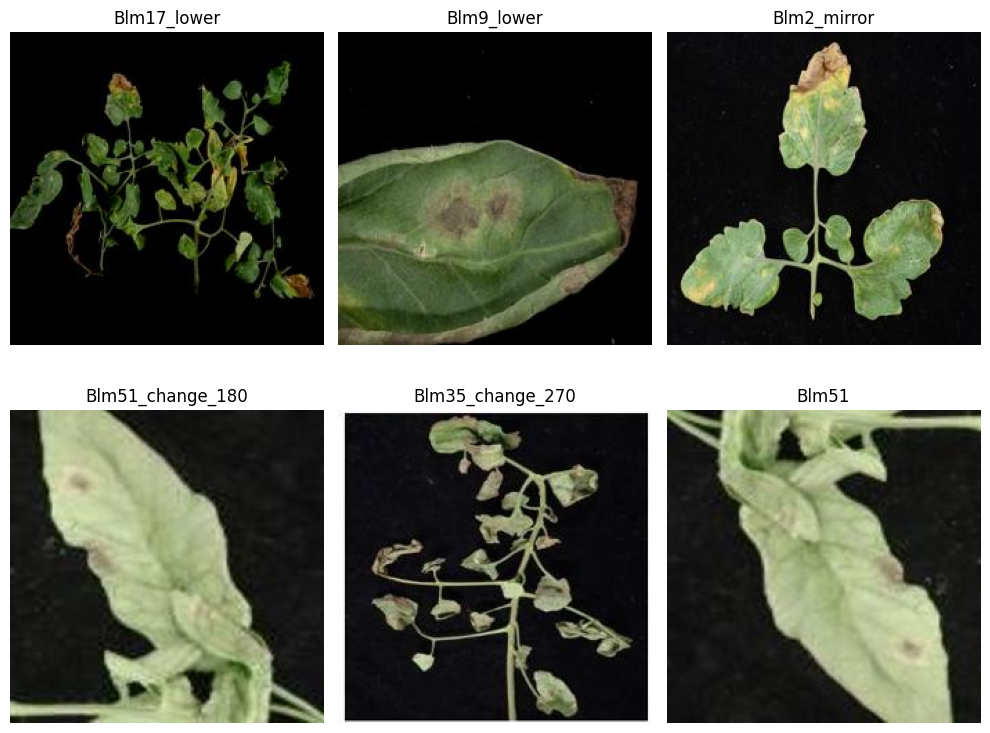

In [145]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Black mold"
image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(10, 8))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Gray Spot

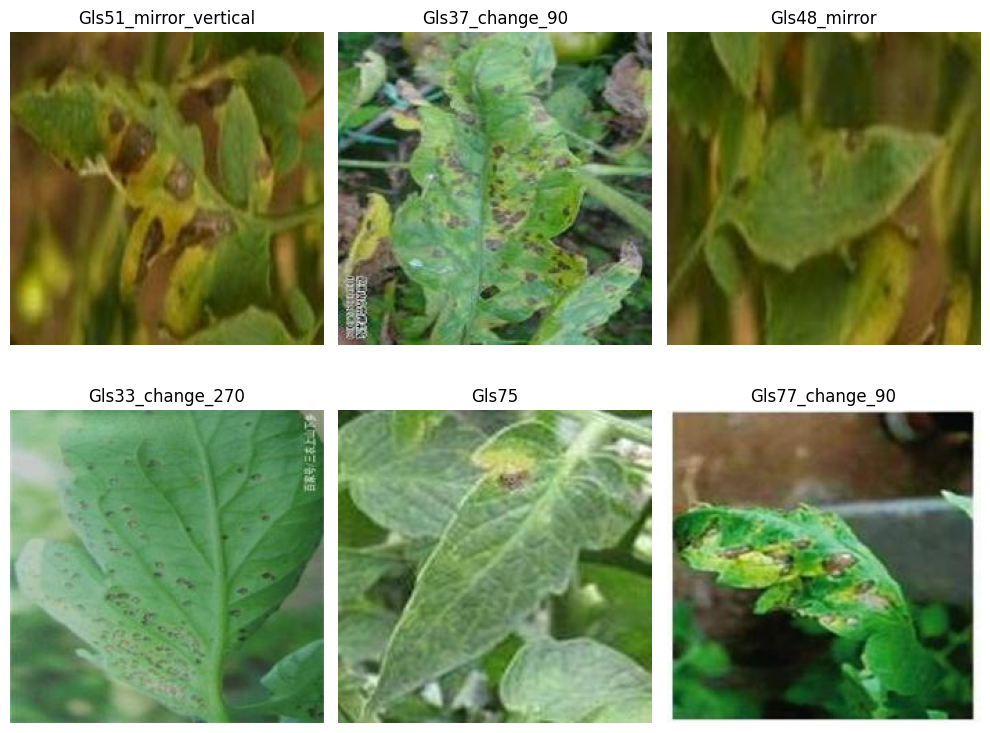

In [146]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Gray spot"
image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(10, 8))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Powdery Mildew

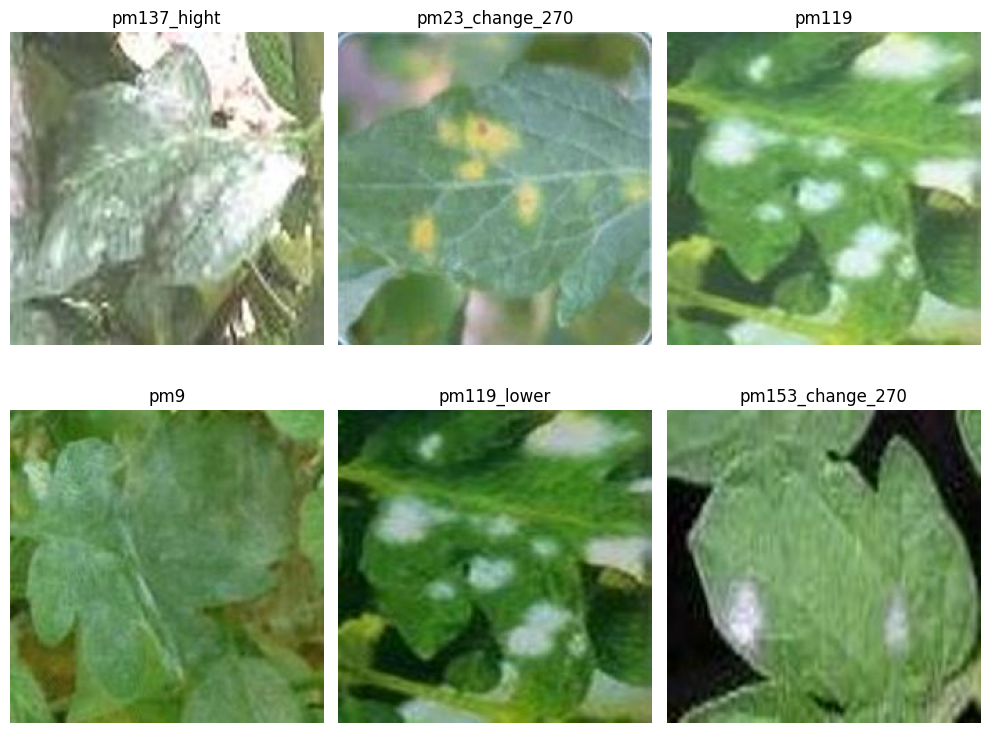

In [147]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/powdery mildew"
image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(10, 8))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Yellow Leaf Curl Virus

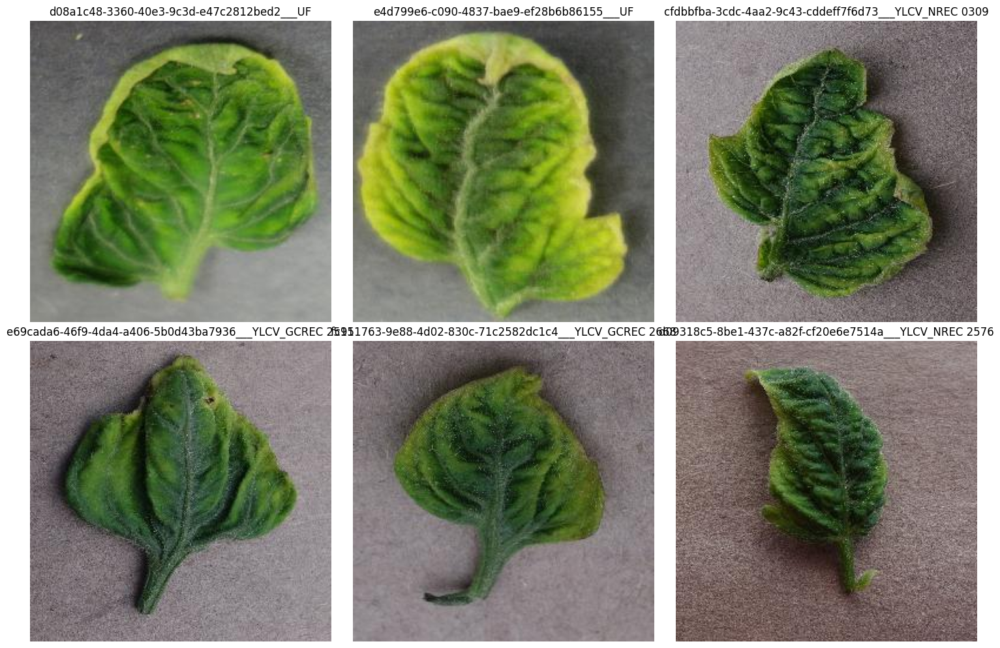

In [148]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Tomato_Yellow_Leaf_Curl_Virus"
image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Mosaic Virus

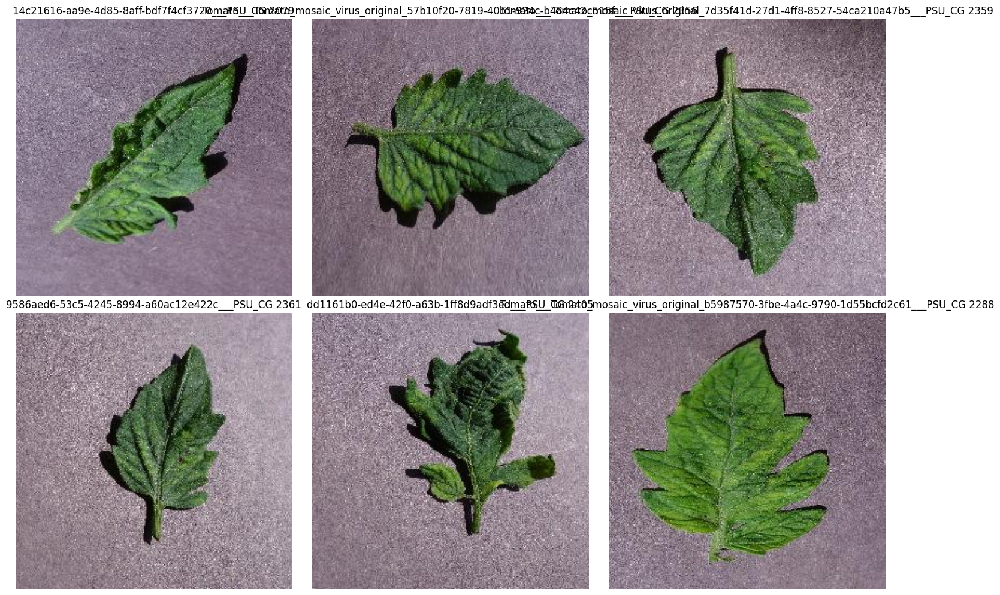

In [149]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Tomato_mosaic_virus"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Target Spots

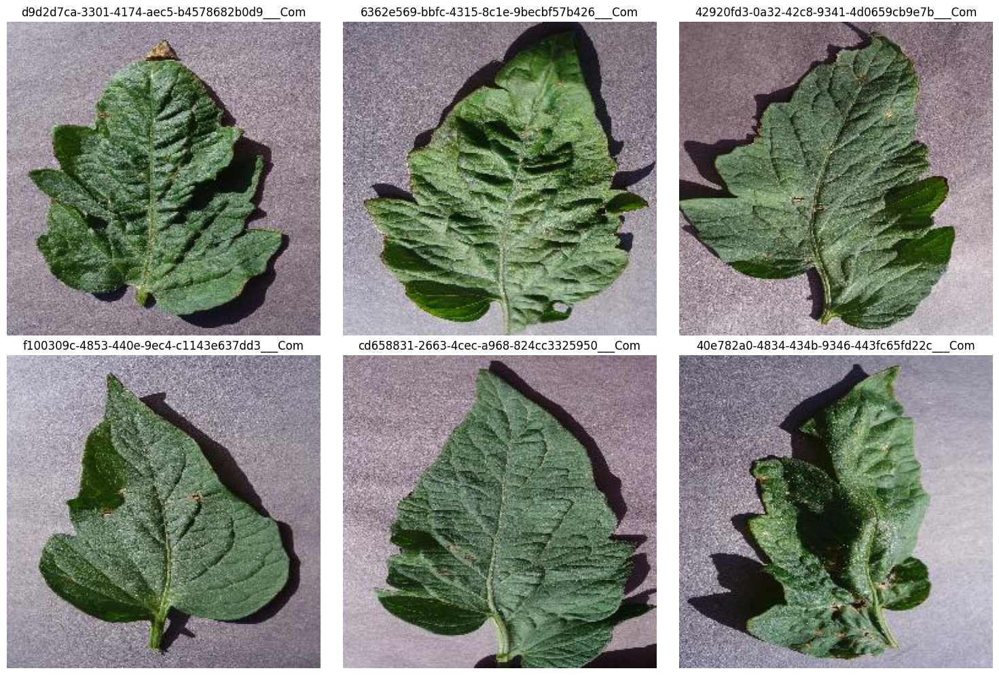

In [150]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Target_Spot"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Spider Mites Two-spotted spider mite

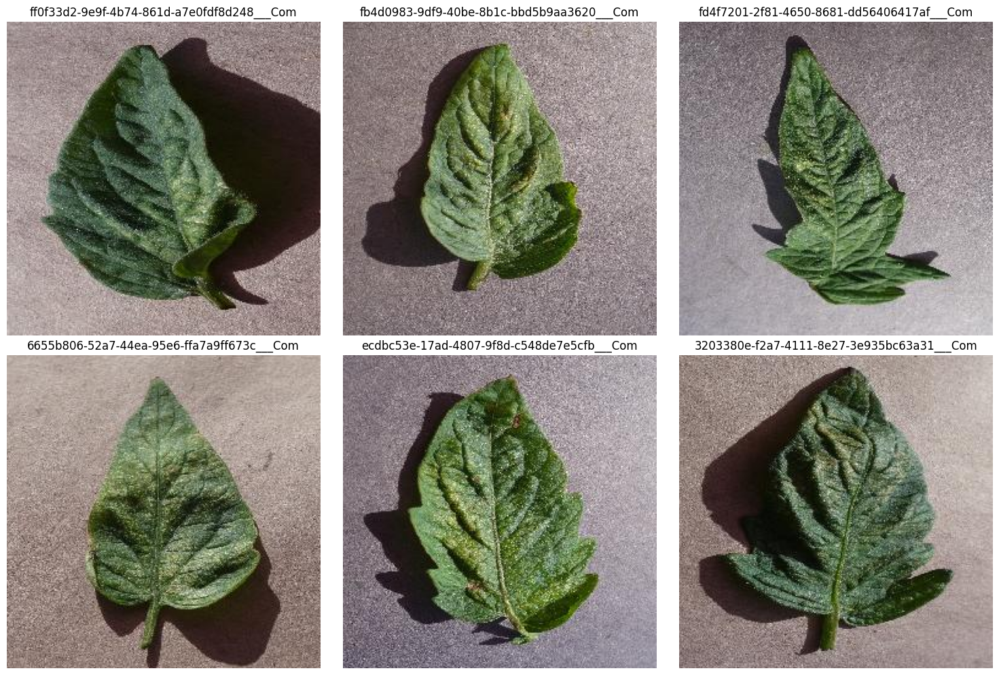

In [151]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Spider_mites Two-spotted_spider_mite"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Septoria Leaf Spot

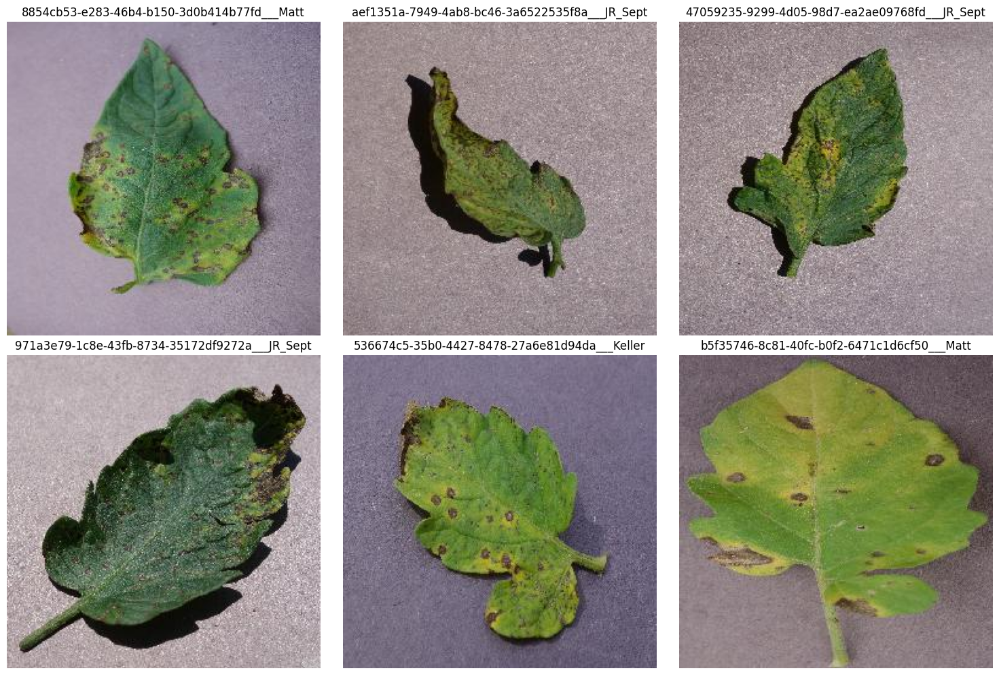

In [152]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Septoria_leaf_spot"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Leaf Mold

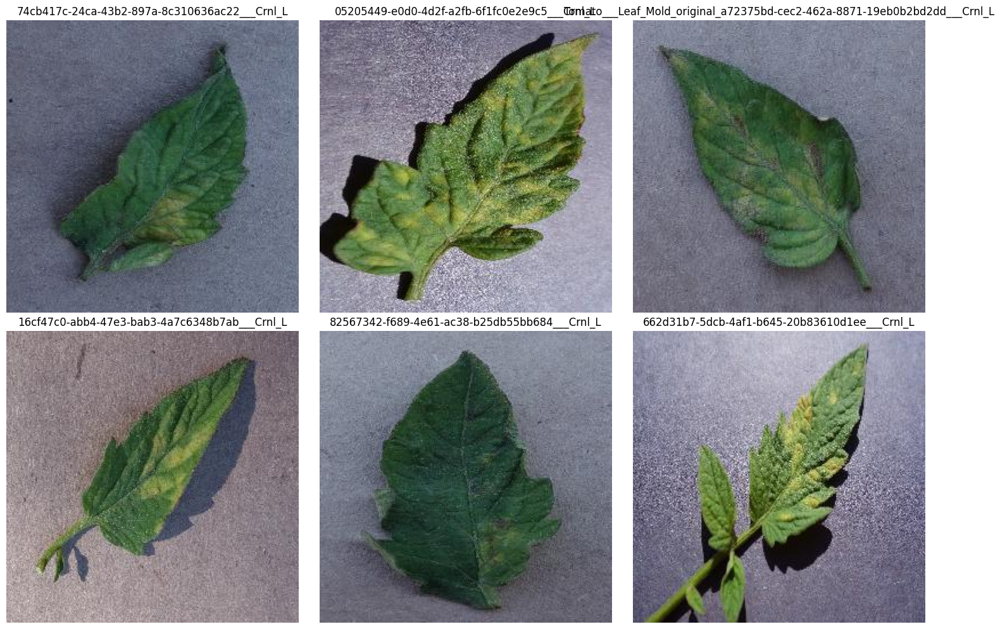

In [153]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Leaf_Mold"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Late Blight

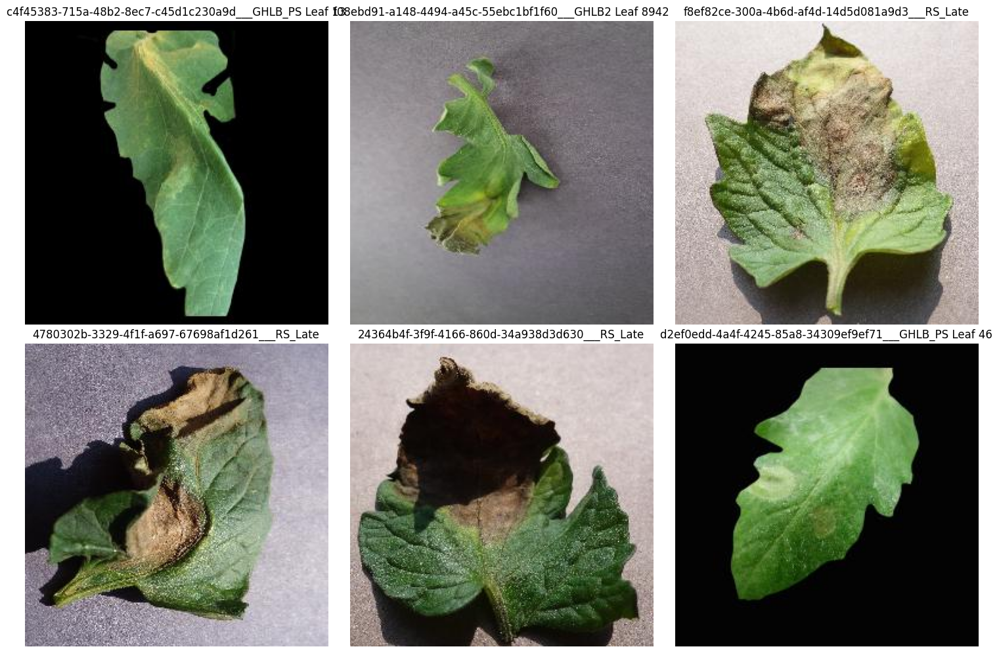

In [154]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Late_blight"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Early Blight

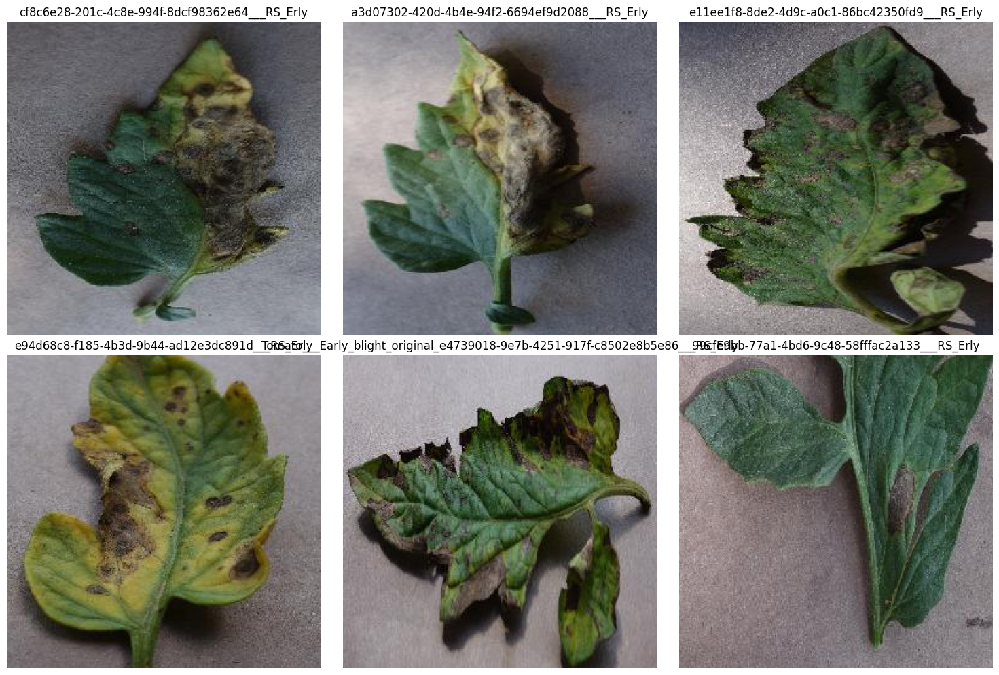

In [155]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Early_blight"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Bacterial Spot

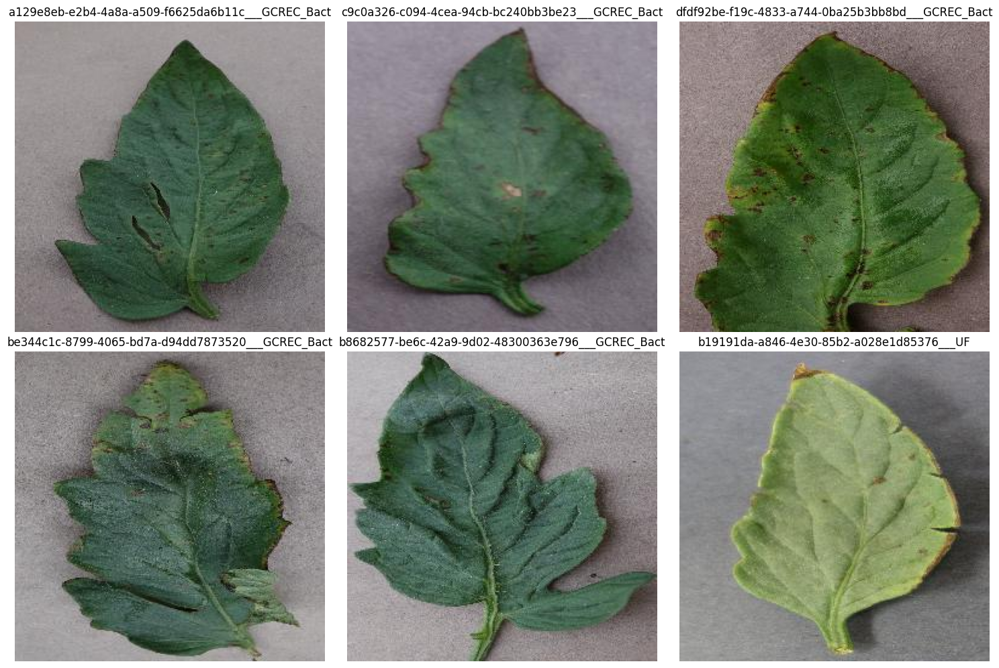

In [156]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___Bacterial_spot"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

### Tomato Healthy Leaves

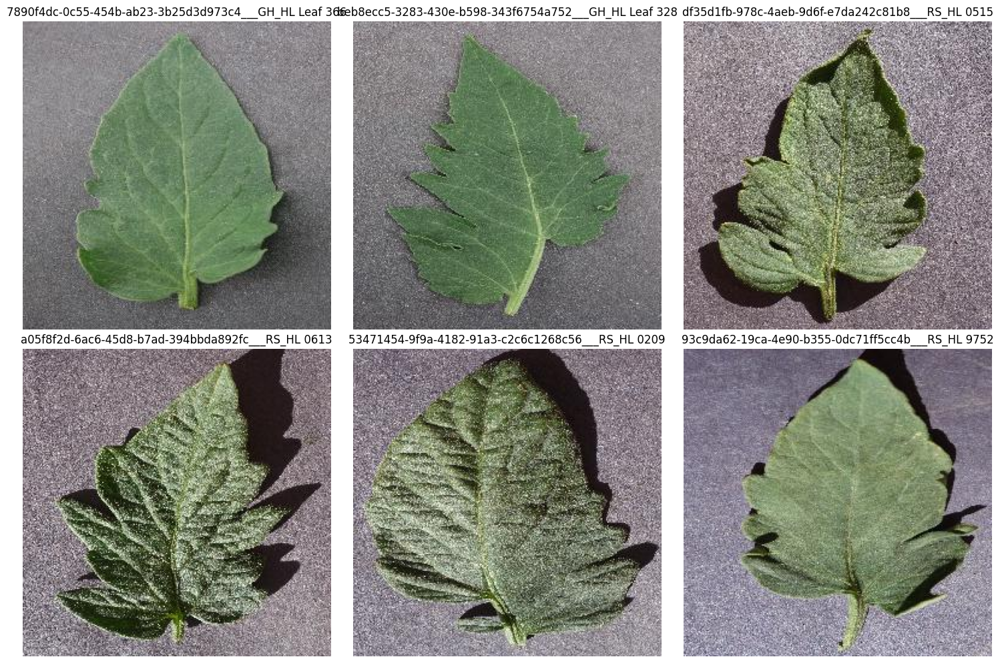

In [157]:
path = "/kaggle/input/tomatodiseasedleaves/tomato/train/Tomato___healthy"

image_files = [f for f in os.listdir(path) if os.path.isfile(os.path.join(path, f))]

fig, axs = plt.subplots(2, 3, figsize=(15, 10))

for i in range(6):
    image_file = image_files[i]
    label = image_file.split('.')[0]

    img_path = os.path.join(path, image_file)
    img = mpimg.imread(img_path)
    ax = axs[i // 3, i % 3]
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(label)

plt.tight_layout()
plt.show()

## Model Building
### Creating a Layer for Resizing and Normalization
Before we feed our images to network, we should be resizing it to the desired size. Moreover, to improve model performance, we should normalize the image pixel value (keeping them in range 0 and 1 by dividing by 256). This should happen while training as well as inference. Hence we can add that as a layer in our Sequential Model.

This will be useful when we are done with the training and start using the model for predictions. At that time somone can supply an image that is not (256,256) and this layer will resize it

In [158]:
IMAGE_SIZE = 256
from tensorflow.keras.layers import Resizing, Rescaling
resize_and_rescale = tf.keras.Sequential([
  Resizing(IMAGE_SIZE, IMAGE_SIZE),
  Rescaling(1./255)
])


## Model Architecture
### Data Augmentation
This boosts the accuracy of our model by augmenting the data.

In [159]:
from tensorflow.keras.layers import RandomFlip, RandomRotation
data_augmentation = tf.keras.Sequential([
  RandomFlip("horizontal_and_vertical"),
  RandomRotation(0.2),
])


In [160]:
train_ds = train_data.map(
    lambda x, y: (data_augmentation(x, training=True), y)
).prefetch(buffer_size=tf.data.AUTOTUNE)

In [161]:
import tensorflow as tf

def resize_images(image, label):
    image = tf.image.resize(image, [256, 256])  # Resize to 256x256
    return image, label

train_data = train_data.map(resize_images)
val_data = val_data.map(resize_images)

### Adding L2-Regularization

In [162]:
from tensorflow.keras import models, layers
from tensorflow.keras.layers import Input

BATCH_SIZE = 32
IMAGE_SIZE = 256
CHANNELS = 3
n_classes = 13

input_shape = (IMAGE_SIZE, IMAGE_SIZE, CHANNELS)
model = models.Sequential([
    Input(shape=input_shape),
    resize_and_rescale,
    layers.Conv2D(32, kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64,  kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64,  kernel_size = (3,3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(n_classes, activation='softmax'),
])


In [163]:
conv_base = DenseNet121(
    weights='imagenet',
    include_top = False,
    input_shape=(256,256,3),
    pooling='avg'
)

In [164]:
conv_base.trainable = False

In [165]:
model = Sequential()
model.add(conv_base)
model.add(BatchNormalization())
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.35))
model.add(BatchNormalization())
model.add(Dense(120, activation='relu'))
model.add(Dense(13, activation='softmax'))

## Compiling the Model
We use adam Optimizer, SparseCategoricalCrossentropy for losses, accuracy as a metric

In [166]:
model.compile(optimizer=Adam(), loss='categorical_crossentropy', metrics=['accuracy'])

In [167]:
import tensorflow as tf
import numpy as np
import random
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

SEED = 42
tf.random.set_seed(SEED)
np.random.seed(SEED)
random.seed(SEED)

early_stopping = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)  
checkpoint_callback = ModelCheckpoint("best_model.keras", monitor="val_accuracy", save_best_only=True, mode="max", verbose=1)

history = model.fit(
    train_data,
    epochs=100,
    validation_data=val_data,
    callbacks=[early_stopping, checkpoint_callback]
)

model = tf.keras.models.load_model("best_model.keras")

Epoch 1/100
375/375 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - accuracy: 0.6534 - loss: 1.0805
Epoch 1: val_accuracy improved from -inf to 0.88641, saving model to best_model.keras
375/375 ━━━━━━━━━━━━━━━━━━━━ 62s 117ms/step - accuracy: 0.6538 - loss: 1.0794 - val_accuracy: 0.8864 - val_loss: 0.3212
Epoch 2/100
374/375 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.8927 - loss: 0.3152
Epoch 2: val_accuracy improved from 0.88641 to 0.91751, saving model to best_model.keras
375/375 ━━━━━━━━━━━━━━━━━━━━ 27s 72ms/step - accuracy: 0.8927 - loss: 0.3150 - val_accuracy: 0.9175 - val_loss: 0.2216
Epoch 3/100
374/375 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.9258 - loss: 0.2107
Epoch 3: val_accuracy improved from 0.91751 to 0.93577, saving model to best_model.keras
375/375 ━━━━━━━━━━━━━━━━━━━━ 27s 72ms/step - accuracy: 0.9258 - loss: 0.2106 - val_accuracy: 0.9358 - val_loss: 0.1901
Epoch 4/100
374/375 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - accuracy: 0.9290 - loss: 0.1907
Epoch 4: val_accuracy impr

In [168]:
evaluation = model.evaluate(val_data)
train_acc = history.history['accuracy'][-1]
val_acc = history.history['val_accuracy'][-1]
print(f"Final Training Accuracy: {train_acc:.2f}")
print(f"Final Validation Accuracy: {val_acc:.2f}")
print("Validation Loss:", evaluation[0])
print("Validation Accuracy:", evaluation[1])

47/47 ━━━━━━━━━━━━━━━━━━━━ 15s 129ms/step - accuracy: 0.9696 - loss: 0.1104
Final Training Accuracy: 0.97
Final Validation Accuracy: 0.96
Validation Loss: 0.11568959057331085
Validation Accuracy: 0.9655172228813171


**You can see above that we get 96.55% accuracy for our test dataset. This is considered to be a good accuracy**

## Graphical Feature Representation

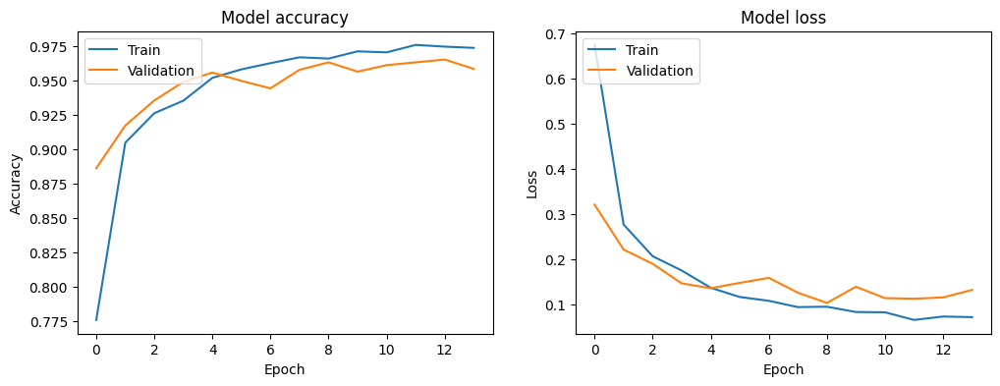

In [169]:
# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.show()

## Results and Findings

In [170]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

class_names = ['Black mold', 'Gray spot', 'Tomato__Bacterial_spot', 'Tomato__Early_blight', 'Tomato__Late_blight', 
               'Tomato__Leaf_Mold', 'Tomato__Septoria_leaf_spot', 'Tomato__Spider_mites Two-spotted_spider_mite', 'Tomato__Target_Spot', 'Tomato__Tomato_Yellow_Leaf_Curl_Virus', 
               'Tomato__healthy', 'powdery mildew', 'Tomato__Tomato_mosaic_virus']  

# Make predictions on the validation set
val_images = []
val_labels = []
val_predictions = []

for images, labels in val_data:
    preds = model.predict(images)
    val_images.extend(images)
    val_labels.extend(labels)
    val_predictions.extend(preds)

val_images = np.array(val_images)
val_labels = np.argmax(np.array(val_labels), axis=1)
val_predictions = np.argmax(np.array(val_predictions), axis=1)

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━

In [171]:
report = classification_report(val_labels, val_predictions, target_names=class_names)
print(report)

                                              precision    recall  f1-score   support

                                  Black mold       0.99      0.98      0.99       108
                                   Gray spot       0.99      0.99      0.99       135
                      Tomato__Bacterial_spot       0.93      1.00      0.97       100
                        Tomato__Early_blight       0.91      0.90      0.90       100
                         Tomato__Late_blight       0.91      0.98      0.94       100
                           Tomato__Leaf_Mold       0.99      0.92      0.95       100
                  Tomato__Septoria_leaf_spot       0.98      0.94      0.96       100
Tomato__Spider_mites Two-spotted_spider_mite       0.93      0.95      0.94        84
                         Tomato__Target_Spot       0.94      0.88      0.91       100
       Tomato__Tomato_Yellow_Leaf_Curl_Virus       0.97      0.96      0.96       100
                             Tomato__healthy       0.

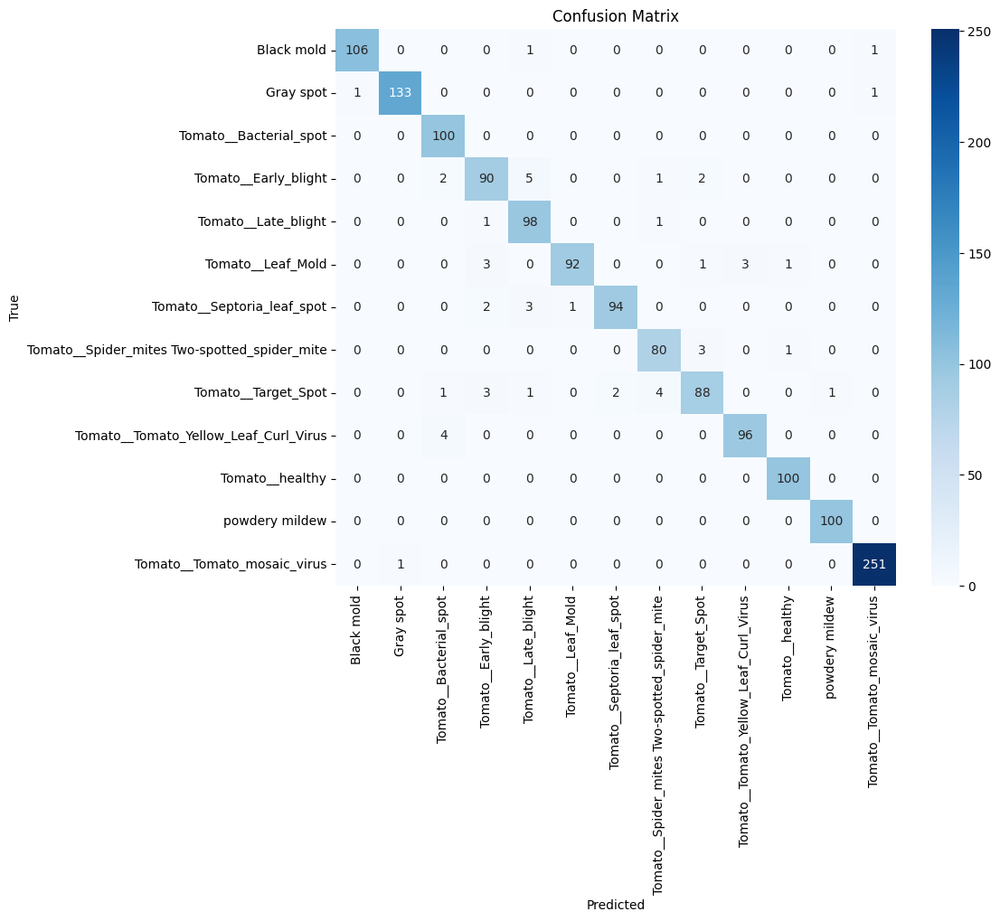

In [172]:
conf_matrix = confusion_matrix(val_labels, val_predictions)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()

# END